1. Importing Packages

Let's dive right in! In this first cell, we will import the libraries and packages we will be using in this project and print their version numbers. This is an important step to make sure we are all on the same page; furthermore, it will help others reproduce the results we obtain.

In [41]:
# check package versions
import sys
import keras
import cv2
import numpy
import matplotlib
import skimage

print('Python: {}'.format(sys.version))
print('Keras: {}'.format(keras.__version__))
print('OpenCV: {}'.format(cv2.__version__))
print('NumPy: {}'.format(numpy.__version__))
print('Matplotlib: {}'.format(matplotlib.__version__))
print('Scikit-Image: {}'.format(skimage.__version__))

Python: 3.12.9 | packaged by Anaconda, Inc. | (main, Feb  6 2025, 12:55:12) [Clang 14.0.6 ]
Keras: 3.8.0
OpenCV: 4.11.0
NumPy: 1.26.4
Matplotlib: 3.9.2
Scikit-Image: 0.24.0


In [42]:
# Import necessary libraries
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.optimizers import Adam
from skimage.metrics import structural_similarity as ssim  # Updated import
from matplotlib import pyplot as plt
import cv2
import numpy as np
import math
import os

# Python magic function to display pyplot figures in Jupyter Notebook
%matplotlib inline


2. Image Quality Metrics

To start, lets define a couple of functions that we can use to calculate the PSNR, MSE, and SSIM. The structural similiarity (SSIM) index was imported directly from the scikit-image library; however, we will have to define our own functions for the PSNR and MSE. Furthermore, we will wrap all three of these metrics into a single function that we can call later.

In [44]:
# define a function for peak signal-to-noise ratio (PSNR)
def psnr(target, ref):
         
    # assume RGB image
    target_data = target.astype(float)
    ref_data = ref.astype(float)

    diff = ref_data - target_data
    diff = diff.flatten('C')

    rmse = math.sqrt(np.mean(diff ** 2.))

    return 20 * math.log10(255. / rmse)

# define function for mean squared error (MSE)
def mse(target, ref):
    # the MSE between the two images is the sum of the squared difference between the two images
    err = np.sum((target.astype('float') - ref.astype('float')) ** 2)
    err /= float(target.shape[0] * target.shape[1])
    
    return err

# define function that combines all three image quality metrics
def compare_images(target, ref):
    scores = []
    scores.append(psnr(target, ref))
    scores.append(mse(target, ref))
    scores.append(ssim(target, ref, multichannel =True))
    
    return scores

3. Preparing Images

For this project, we will be using the same images that were used in the original SRCNN paper. We can download these images from http://mmlab.ie.cuhk.edu.hk/projects/SRCNN.html. The .zip file identified as the MATLAB code contains the images we want. Copy both the Set5 and Set14 datasets into a new folder called 'source'.

Now that we have some images, we want to produce low resolution versions of these same images. We can accomplish this by resizing the images, both downwards and upwards, using OpeCV. There are several interpolation methods that can be used to resize images; however, we will be using bilinear interpolation.

Once we produce these low resolution images, we can save them in a new folder.

In [45]:
import os
import cv2

def prepare_images(source_path, factor):
    # Get absolute path and verify
    source_path = os.path.abspath(source_path)
    if not os.path.exists(source_path):
        print(f"Error: Source directory not found at {source_path}")
        return

    # Create output directory
    base_dir = os.path.dirname(source_path)
    output_dir = os.path.join(base_dir, "images")
    os.makedirs(output_dir, exist_ok=True)

    print(f"Processing images from: {source_path}")
    
    for file in os.listdir(source_path):
        # Skip hidden files (like .DS_Store) and directories
        if file.startswith('.') or os.path.isdir(os.path.join(source_path, file)):
            continue
            
        file_path = os.path.join(source_path, file)
        img = cv2.imread(file_path)
        
        if img is None:
            print(f"Warning: Could not read {file} (unsupported format?). Skipping...")
            continue

        # Resize operations
        h, w = img.shape[:2]
        img = cv2.resize(img, (w//factor, h//factor), interpolation=cv2.INTER_LINEAR)
        img = cv2.resize(img, (w, h), interpolation=cv2.INTER_LINEAR)

        # Save output
        output_path = os.path.join(output_dir, file)
        cv2.imwrite(output_path, img)
        print(f"✅ Processed: {file}")

# Example usage (use your correct path)
prepare_images('/Users/dhruvnagori/Desktop/DL/Project/source', 2)

Processing images from: /Users/dhruvnagori/Desktop/DL/Project/source
✅ Processed: foreman.bmp
✅ Processed: woman_GT.bmp
✅ Processed: man.bmp
✅ Processed: pepper.bmp
✅ Processed: comic.bmp
✅ Processed: coastguard.bmp
✅ Processed: butterfly_GT.bmp
✅ Processed: baboon.bmp
✅ Processed: bird_GT.bmp
✅ Processed: monarch.bmp
✅ Processed: flowers.bmp
✅ Processed: face.bmp
✅ Processed: head_GT.bmp
✅ Processed: baby_GT.bmp
✅ Processed: ppt3.bmp
✅ Processed: zebra.bmp
✅ Processed: bridge.bmp
✅ Processed: barbara.bmp
✅ Processed: lenna.bmp


3. Testing Low Resolution Images

To ensure that our image quality metrics are being calculated correctly and that the images were effectively degraded, lets calculate the PSNR, MSE, and SSIM between our reference images and the degraded images that we just prepared.

In [46]:
import os
import cv2
import numpy as np
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import mean_squared_error as mse
from skimage.metrics import structural_similarity as ssim

def compare_images(target, ref):
    """Calculate PSNR, MSE, and SSIM between two images"""
    # Convert to grayscale for SSIM
    target_gray = cv2.cvtColor(target, cv2.COLOR_BGR2GRAY)
    ref_gray = cv2.cvtColor(ref, cv2.COLOR_BGR2GRAY)
    
    # Calculate metrics
    psnr_value = psnr(ref, target)
    mse_value = mse(ref, target)
    ssim_value = ssim(ref_gray, target_gray)
    
    return psnr_value, mse_value, ssim_value

def test_images():
    for file in os.listdir('images'):
        # Skip directories and hidden files
        if os.path.isdir(os.path.join('images', file)) or file.startswith('.'):
            continue
            
        try:
            # Read images
            target = cv2.imread(os.path.join('images', file))
            ref = cv2.imread(os.path.join('source', file))
            
            if target is None or ref is None:
                print(f"Warning: Could not read {file}. Skipping...")
                continue
            
            # Calculate scores
            psnr_val, mse_val, ssim_val = compare_images(target, ref)
            
            # Print results
            print(f"\nImage: {file}")
            print(f"PSNR: {psnr_val:.2f} dB")
            print(f"MSE: {mse_val:.2f}")
            print(f"SSIM: {ssim_val:.4f}\n")
            
        except Exception as e:
            print(f"Error processing {file}: {str(e)}")

# Run the tests
test_images()


Image: foreman.bmp
PSNR: 30.14 dB
MSE: 62.90
SSIM: 0.9342


Image: woman_GT.bmp
PSNR: 29.33 dB
MSE: 75.94
SSIM: 0.9347


Image: man.bmp
PSNR: 27.23 dB
MSE: 123.15
SSIM: 0.8215


Image: pepper.bmp
PSNR: 29.89 dB
MSE: 66.70
SSIM: 0.8858


Image: comic.bmp
PSNR: 23.80 dB
MSE: 271.08
SSIM: 0.8376


Image: coastguard.bmp
PSNR: 27.16 dB
MSE: 125.00
SSIM: 0.7576


Image: butterfly_GT.bmp
PSNR: 24.78 dB
MSE: 216.21
SSIM: 0.8894


Image: baboon.bmp
PSNR: 22.16 dB
MSE: 395.71
SSIM: 0.6709


Image: bird_GT.bmp
PSNR: 32.90 dB
MSE: 33.37
SSIM: 0.9593


Image: monarch.bmp
PSNR: 30.20 dB
MSE: 62.15
SSIM: 0.9472


Image: flowers.bmp
PSNR: 27.45 dB
MSE: 116.85
SSIM: 0.8764


Image: face.bmp
PSNR: 30.99 dB
MSE: 51.74
SSIM: 0.8422


Image: head_GT.bmp
PSNR: 31.02 dB
MSE: 51.41
SSIM: 0.8424


Image: baby_GT.bmp
PSNR: 34.37 dB
MSE: 23.76
SSIM: 0.9407


Image: ppt3.bmp
PSNR: 24.85 dB
MSE: 212.89
SSIM: 0.9325


Image: zebra.bmp
PSNR: 27.91 dB
MSE: 105.22
SSIM: 0.8883


Image: bridge.bmp
PSNR: 25.85 dB
MSE: 

4. Building the SRCNN Model

Now that we have our low resolution images and all three image quality metrics functioning properly, we can start building the SRCNN. In Keras, it's as simple as adding layers one after the other. The achitecture and hyper parameters of the SRCNN network can be obtained from the publication referenced above.

In [47]:
# define the SRCNN model
def model():
    
    # define model type
    SRCNN = Sequential()
    
    # add model layers
    SRCNN.add(Conv2D(filters=128, kernel_size = (9, 9), kernel_initializer='glorot_uniform',
                     activation='relu', padding='valid', use_bias=True, input_shape=(None, None, 1)))
    SRCNN.add(Conv2D(filters=64, kernel_size = (3, 3), kernel_initializer='glorot_uniform',
                     activation='relu', padding='same', use_bias=True))
    SRCNN.add(Conv2D(filters=1, kernel_size = (5, 5), kernel_initializer='glorot_uniform',
                     activation='linear', padding='valid', use_bias=True))
    
    # define optimizer
    adam = Adam(learning_rate=0.0003)
    
    # compile model
    SRCNN.compile(optimizer=adam, loss='mean_squared_error', metrics=['mean_squared_error'])
    
    return SRCNN

5. Deploying the SRCNN

Now that we have defined our model, we can use it for single-image super-resolution. However, before we do this, we will need to define a couple of image processing functions. Furthermore, it will be necessary to preprocess the images extensively before using them as inputs to the network. This processing will include cropping and color space conversions.

Additionally, to save us the time it takes to train a deep neural network, we will be loading pre-trained weights for the SRCNN. These weights can be found at the following GitHub page: https://github.com/MarkPrecursor/SRCNN-keras

Once we have tested our network, we can perform single-image super-resolution on all of our input images. Furthermore, after processing, we can calculate the PSNR, MSE, and SSIM on the images that we produce. We can save these images directly or create subplots to conveniently display the original, low resolution, and high resolution images side by side.

In [48]:
# define necessary image processing functions

def modcrop(img, scale):
    tmpsz = img.shape
    sz = tmpsz[0:2] # We are dropping the channel
    sz = sz - np.mod(sz, scale) #it give the remainder from two value sz and scale and dimension of image is divide by a certain scale
    img = img[0:sz[0], 1:sz[1]]
    return img


def shave(image, border):
    img = image[border: -border, border: -border] # cropping the image
    return img

In [49]:
# define main prediction function

def predict(image_path):
    
    # load the srcnn model with weights
    srcnn = model()
    srcnn.load_weights('3051crop_weight_200.h5')
    
    # load the degraded and reference images
    path, file = os.path.split(image_path)
    degraded = cv2.imread(image_path)
    ref = cv2.imread('source/{}'.format(file))
    
    # preprocess the image with modcrop
    ref = modcrop(ref, 3) # divide by 3 
    degraded = modcrop(degraded, 3)
    
    # convert the image to YCrCb - (srcnn trained on Y channel)
    temp = cv2.cvtColor(degraded, cv2.COLOR_BGR2YCrCb) # in this we use BRG not RGB 
    
    # create image slice and normalize  
    Y = numpy.zeros((1, temp.shape[0], temp.shape[1], 1), dtype=float) # in second their is width and then heigth at third and  1 channel 
    Y[0, :, :, 0] = temp[:, :, 0].astype(float) / 255
    
    # perform super-resolution with srcnn
    pre = srcnn.predict(Y, batch_size=1)
    
    # post-process output
    pre *= 255
    pre[pre[:] > 255] = 255
    pre[pre[:] < 0] = 0
    pre = pre.astype(np.uint8) # for Integer value
    
    # copy Y channel back to image and convert to BGR
    temp = shave(temp, 6) # we will crop the image with the border of 6 (3,3) from both heigth ande width
    temp[:, :, 0] = pre[0, :, :, 0]
    output = cv2.cvtColor(temp, cv2.COLOR_YCrCb2BGR)
    
    # remove border from reference and degraged image
    ref = shave(ref.astype(np.uint8), 6)
    degraded = shave(degraded.astype(np.uint8), 6)
    
    # image quality calculations
    scores = []
    scores.append(compare_images(degraded, ref))
    scores.append(compare_images(output, ref))
    
    # return images and scores
    return ref, degraded, output, scores

In [28]:
def compare_images(img1, img2):
    """Calculate PSNR, MSE, and SSIM between two images"""
    # Convert to grayscale for SSIM calculation
    img1_gray = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    img2_gray = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
    
    psnr_value = psnr(img1, img2)
    mse_value = mse(img1, img2)
    ssim_value = ssim(img1_gray, img2_gray)
    
    return [psnr_value, mse_value, ssim_value]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           27.25       122.52       0.8747
Reconstructed Image:      29.66        70.32       0.9301
--------------------------------------------------



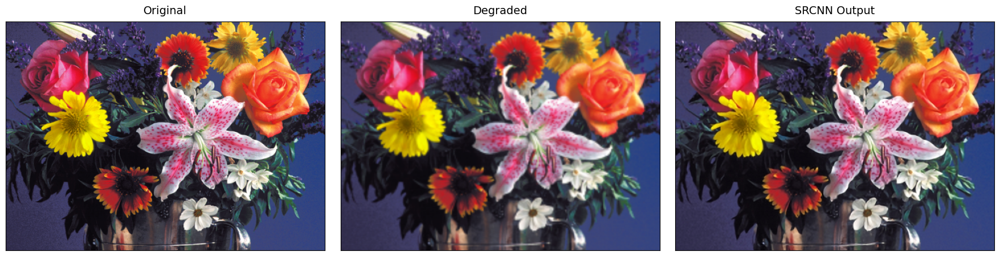

In [55]:
# Get predictions
ref, degraded, output, scores = predict('images/flowers.bmp')

# Print scores with improved formatting
print('\n' + '-'*50)
print('{:<20} {:>10} {:>12} {:>12}'.format('', 'PSNR (dB)', 'MSE', 'SSIM'))
print('-'*50)
print('{:<20} {:>10.2f} {:>12.2f} {:>12.4f}'.format('Degraded Image:', 
                                                   scores[0][0], 
                                                   scores[0][1], 
                                                   scores[0][2]))
print('{:<20} {:>10.2f} {:>12.2f} {:>12.4f}'.format('Reconstructed Image:', 
                                                   scores[1][0], 
                                                   scores[1][1], 
                                                   scores[1][2]))
print('-'*50 + '\n')

# Display images with enhanced styling
fig, axs = plt.subplots(1, 3, figsize=(18, 6))
titles = ['Original', 'Degraded', 'SRCNN Output']
images = [ref, degraded, output]

for ax, img, title in zip(axs, images, titles):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.set_title(title, fontsize=14, pad=10)
    ax.set_xticks([])
    ax.set_yticks([])
    
plt.tight_layout(pad=2.0)  # Adjust padding between subplots
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           32.04        40.61       0.9392
Reconstructed Image:      36.15        15.79       0.9655
--------------------------------------------------



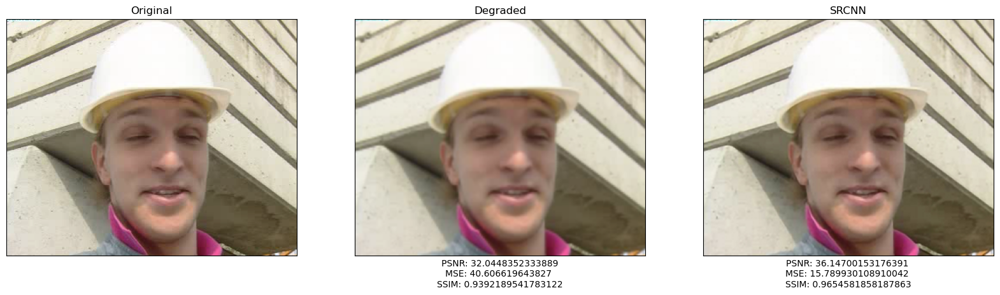

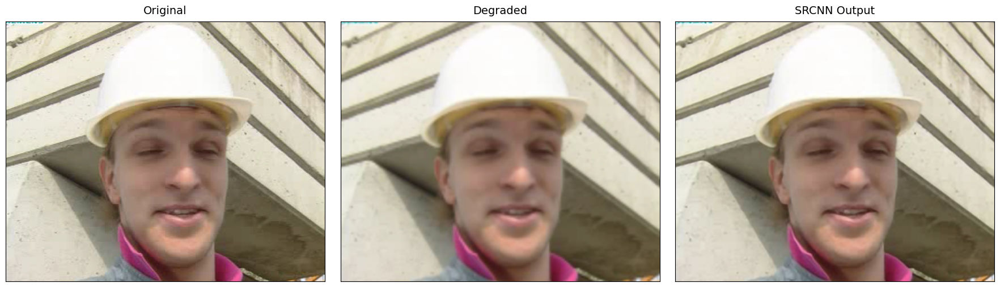

Saving foreman.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           29.38        74.96       0.9349
Reconstructed Image:      33.63        28.21       0.9677
--------------------------------------------------



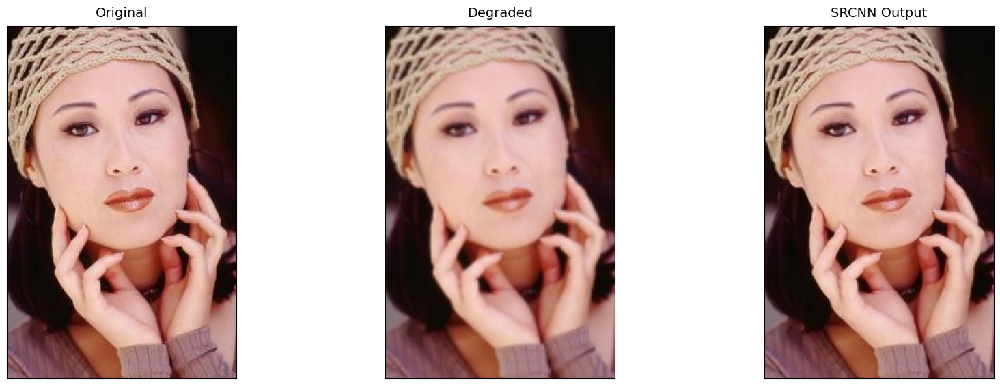

Saving woman_GT.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           27.14       125.56       0.8207
Reconstructed Image:      29.20        78.19       0.8767
--------------------------------------------------



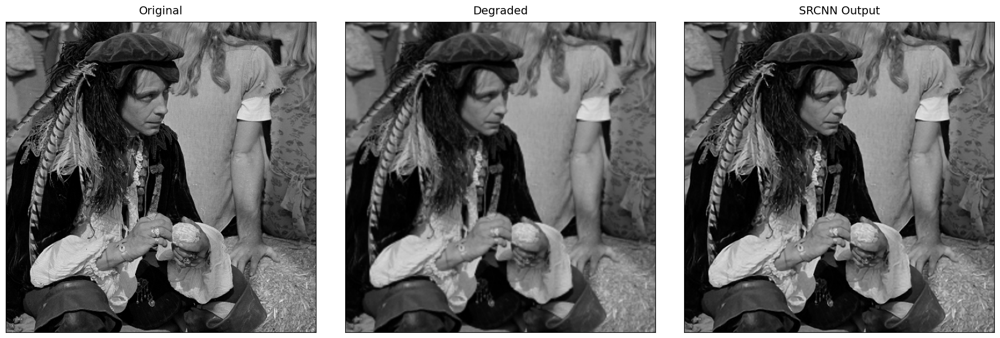

Saving man.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           31.45        46.60       0.8881
Reconstructed Image:      32.78        34.26       0.9085
--------------------------------------------------



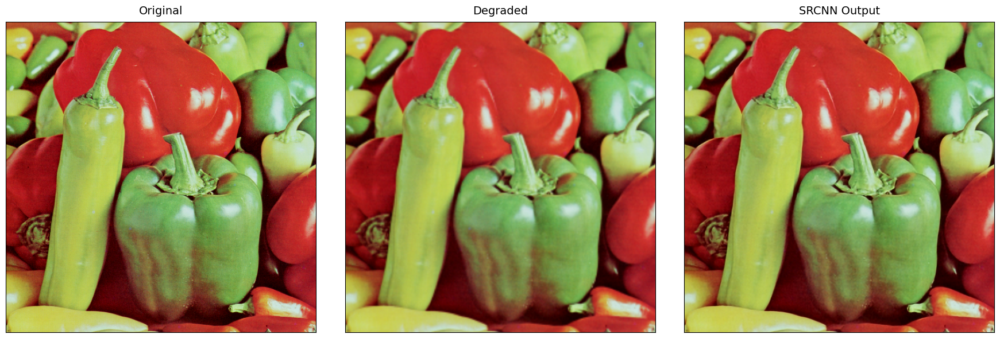

Saving pepper.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           23.64       281.51       0.8322
Reconstructed Image:      25.88       167.82       0.9108
--------------------------------------------------



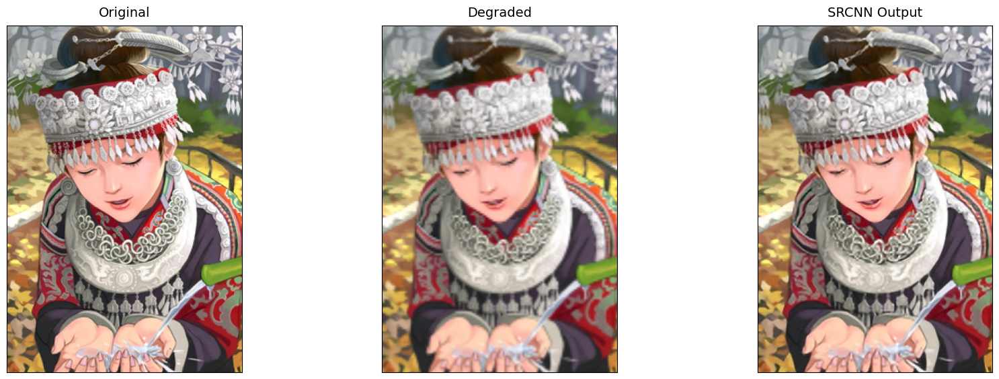

Saving comic.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           27.37       119.18       0.7533
Reconstructed Image:      28.67        88.24       0.8301
--------------------------------------------------



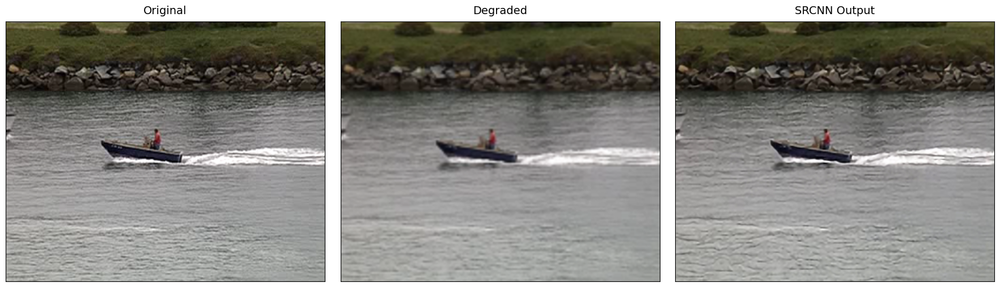

Saving coastguard.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           24.75       217.69       0.8897
Reconstructed Image:      30.38        59.55       0.9590
--------------------------------------------------



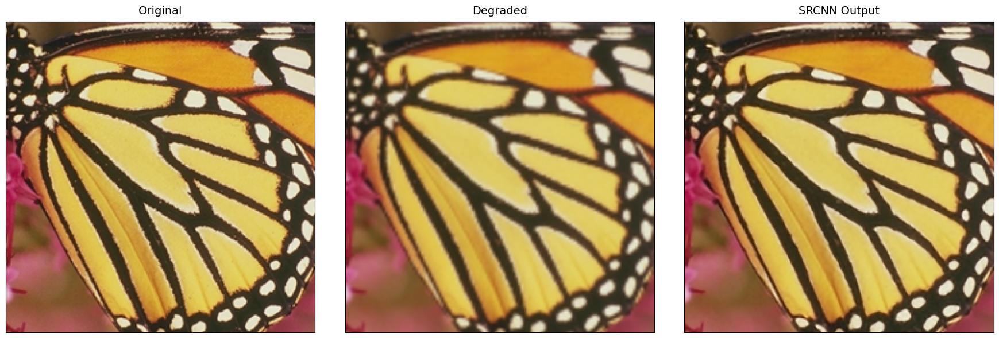

Saving butterfly_GT.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 161ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           22.29       384.21       0.6735
Reconstructed Image:      23.04       323.23       0.7675
--------------------------------------------------



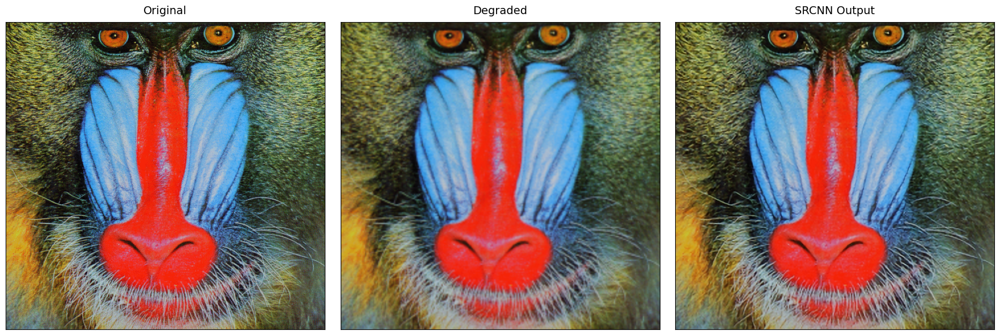

Saving baboon.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           32.97        32.80       0.9593
Reconstructed Image:      36.55        14.40       0.9846
--------------------------------------------------



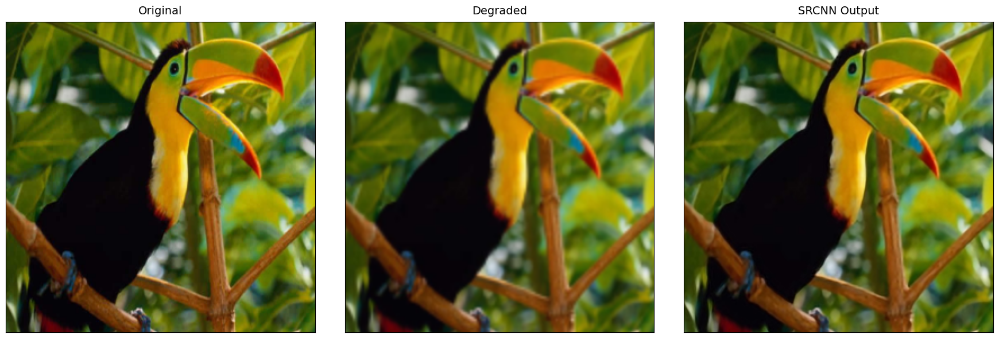

Saving bird_GT.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           30.04        64.37       0.9466
Reconstructed Image:      35.13        19.94       0.9712
--------------------------------------------------



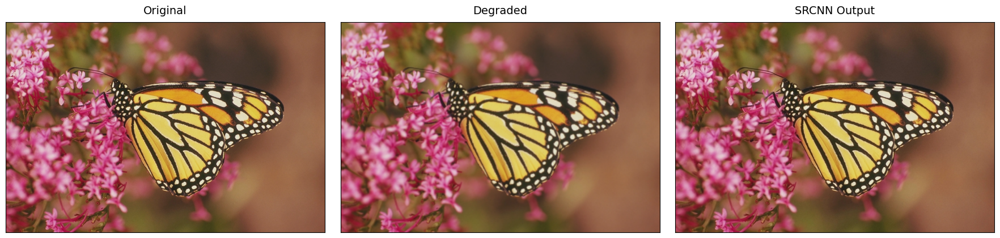

Saving monarch.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           27.25       122.52       0.8747
Reconstructed Image:      29.66        70.32       0.9301
--------------------------------------------------



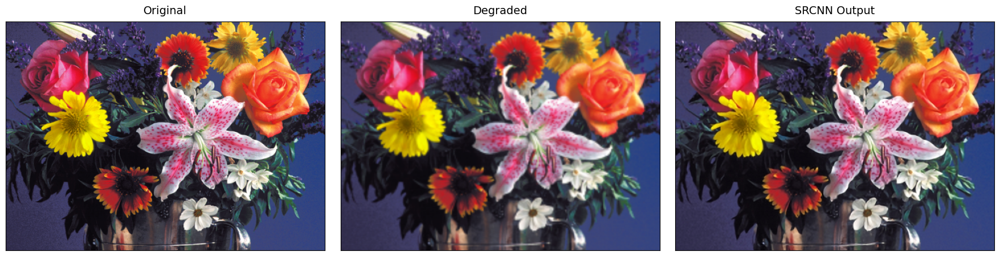

Saving flowers.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           30.88        53.07       0.8419
Reconstructed Image:      31.64        44.56       0.8735
--------------------------------------------------



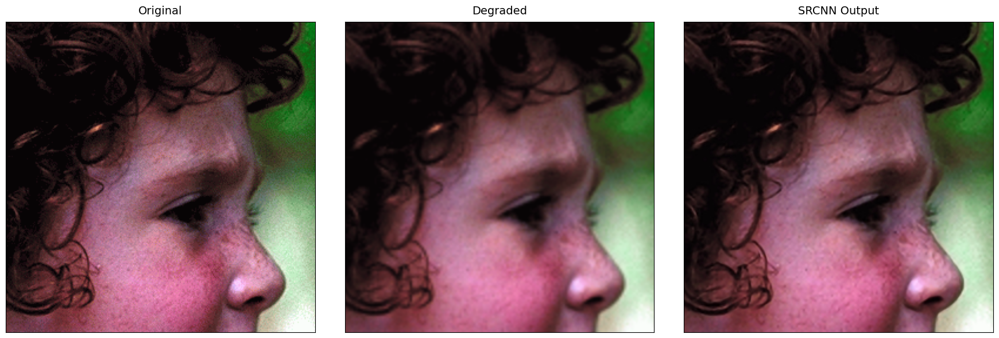

Saving face.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           30.91        52.68       0.8422
Reconstructed Image:      31.67        44.27       0.8736
--------------------------------------------------



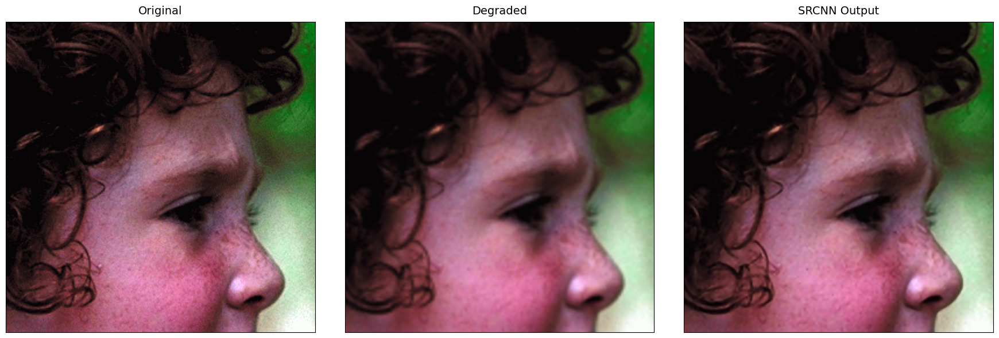

Saving head_GT.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           34.25        24.42       0.9395
Reconstructed Image:      36.26        15.39       0.9613
--------------------------------------------------



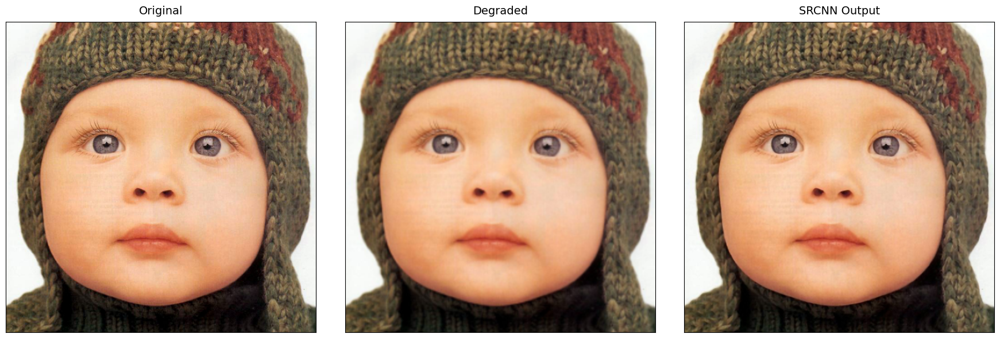

Saving baby_GT.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 235ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           24.65       222.73       0.9294
Reconstructed Image:      27.14       125.54       0.9560
--------------------------------------------------



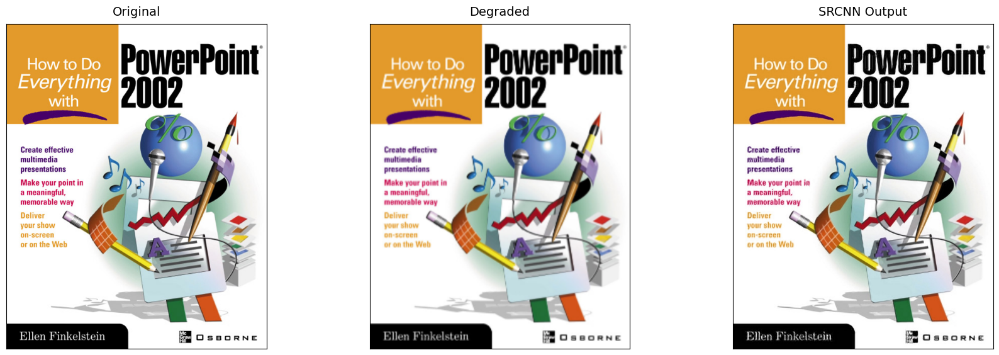

Saving ppt3.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           27.78       108.50       0.8896
Reconstructed Image:      30.41        59.22       0.9324
--------------------------------------------------



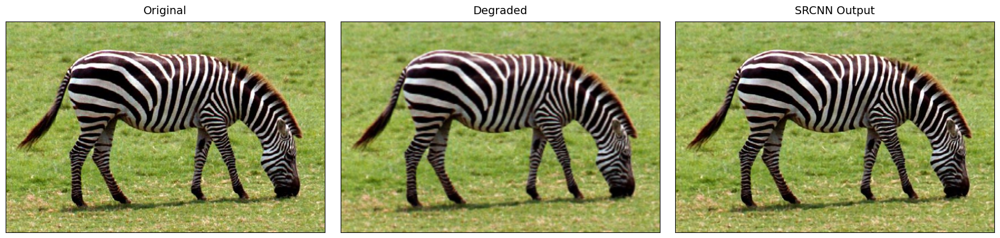

Saving zebra.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           25.95       165.29       0.7822
Reconstructed Image:      27.48       116.30       0.8565
--------------------------------------------------



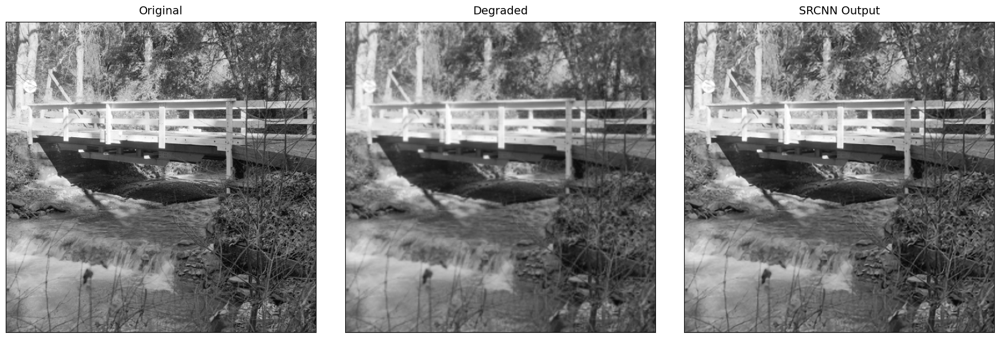

Saving bridge.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 280ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           25.89       167.57       0.8181
Reconstructed Image:      26.58       143.05       0.8683
--------------------------------------------------



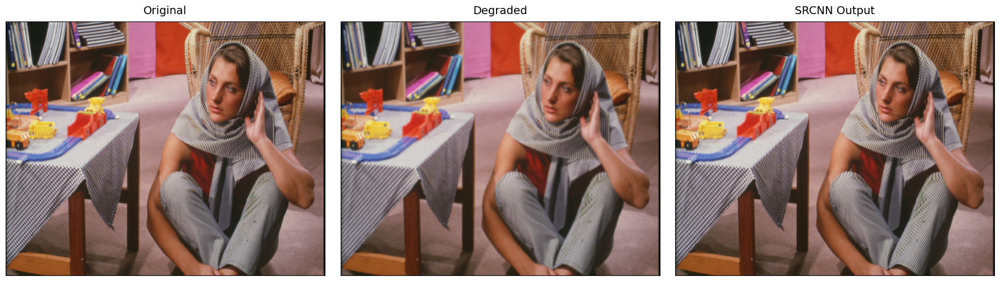

Saving barbara.bmp
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step

--------------------------------------------------
                      PSNR (dB)          MSE         SSIM
--------------------------------------------------
Degraded Image:           31.36        47.56       0.8891
Reconstructed Image:      33.11        31.79       0.9171
--------------------------------------------------



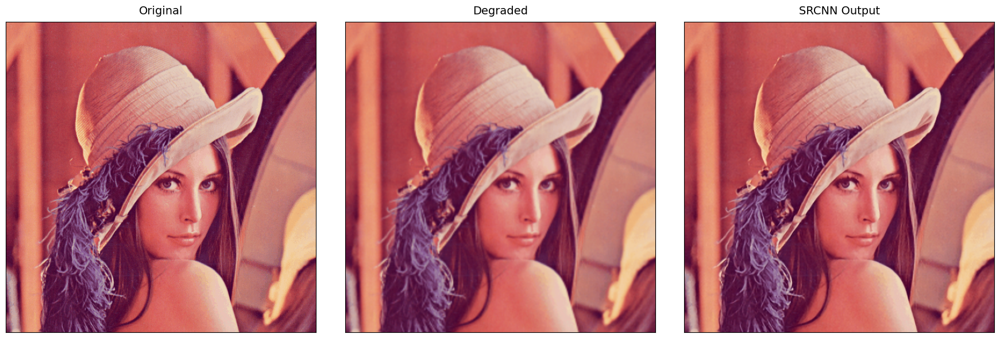

Saving lenna.bmp


In [58]:
for file in os.listdir('images'):

    # perform super-resolution
    ref, degraded, output, scores = predict('images/{}'.format(file))

    # Print scores with improved formatting
    print('\n' + '-'*50)
    print('{:<20} {:>10} {:>12} {:>12}'.format('', 'PSNR (dB)', 'MSE', 'SSIM'))
    print('-'*50)
    print('{:<20} {:>10.2f} {:>12.2f} {:>12.4f}'.format('Degraded Image:', 
                                                   scores[0][0], 
                                                   scores[0][1], 
                                                   scores[0][2]))
    print('{:<20} {:>10.2f} {:>12.2f} {:>12.4f}'.format('Reconstructed Image:', 
                                                   scores[1][0], 
                                                   scores[1][1], 
                                                   scores[1][2]))
    print('-'*50 + '\n')

    # Display images with enhanced styling
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))
    titles = ['Original', 'Degraded', 'SRCNN Output']
    images = [ref, degraded, output]

    for ax, img, title in zip(axs, images, titles):
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax.set_title(title, fontsize=14, pad=10)
        ax.set_xticks([])
        ax.set_yticks([])
    
    plt.tight_layout(pad=2.0)  # Adjust padding between subplots
    plt.show()

    print('Saving {}'.format(file))
    fig.savefig('output/{}.png'.format(os.path.splitext(file)[0])) 
    plt.close()